## Programming Assignment 2

##### Importing Dependencies:

In [1]:
%pip install numpy
%pip install matplotlib
%pip install scikit-image
%pip install opencv-python

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import cv2 as cv

from skimage import filters
from skimage.util import random_noise
from skimage.io import imshow, imread
from skimage.color import rgb2hsv
from skimage.color import rgb2gray


The Image:

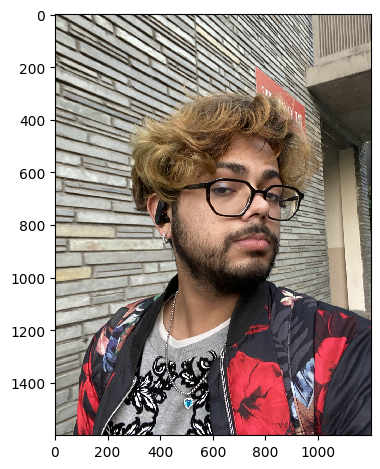

In [3]:
karanOG = imread("karan.jpg")
karan = cv.resize(karanOG, (1200, 1600))
imshow(karan)

Text(0.5, 0, 'Salt and Pepper Noise')

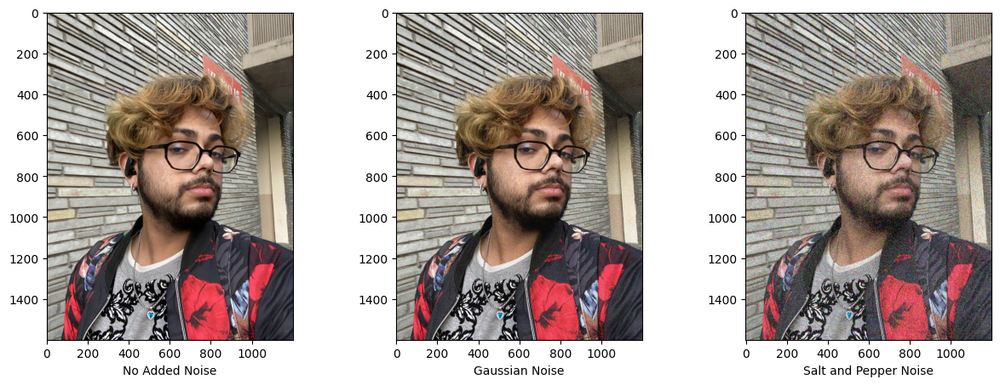

In [4]:
gaussKaran = random_noise(karan, mode = "gaussian")
saltPepKaran = random_noise(karan, mode="s&p", amount=0.2)

fig, ax = plt.subplots(1, 3, figsize=(15, 5))

ax[0].imshow(karan)
ax[0].set_xlabel("No Added Noise")

ax[1].imshow(gaussKaran)
ax[1].set_xlabel("Gaussian Noise")

ax[2].imshow(saltPepKaran)
ax[2].set_xlabel("Salt and Pepper Noise")


### Blurring the image 

Blurring the image for better edge detection and segmentation.

#### Importance of Noise Reduction:  

Most of the mathematics behind edge detection depend heavily on derivatives, and are therefore sensitive to image noise.

Gaussian Blur convolution is a solution to this that I'll be implementing. I will be using a kernel of size 15.


In [5]:
karanBlurred = cv.GaussianBlur(karan, (15, 15), 0)
gaussKaranBlurred = cv.GaussianBlur(gaussKaran, (15, 15), 0)
saltPepKaranBlurred = cv.GaussianBlur(saltPepKaran, (15, 15), 0)

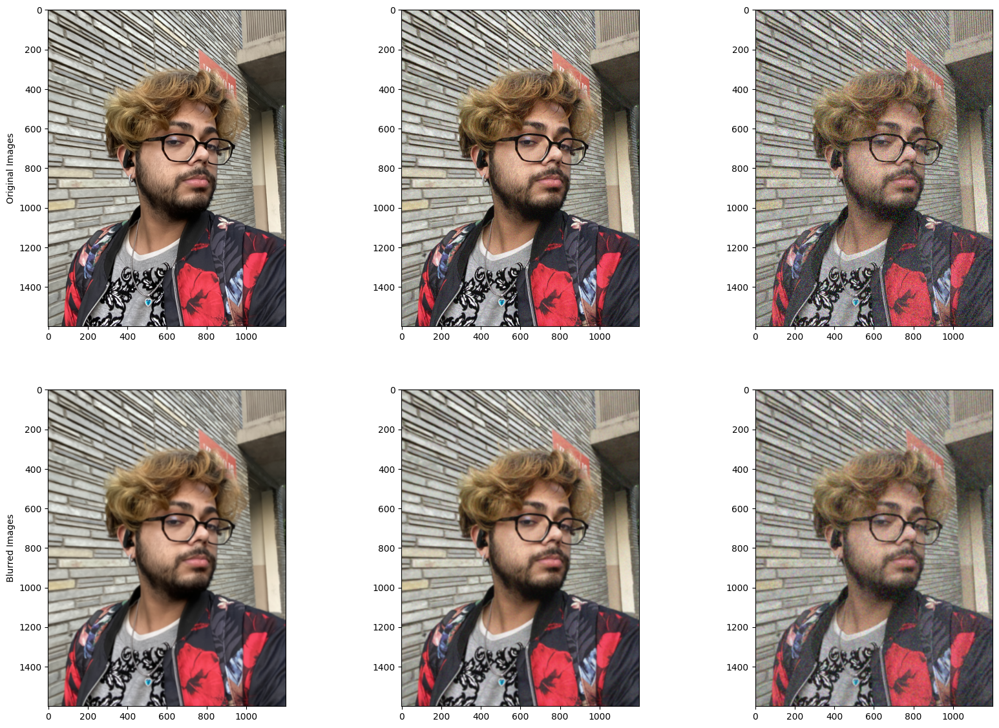

In [6]:
fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(karan)
ax[0][0].set_ylabel("Original Images")

ax[0][1].imshow(gaussKaran)

ax[0][2].imshow(saltPepKaran)

ax[1][0].imshow(karanBlurred)
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(gaussKaranBlurred)

ax[1][2].imshow(saltPepKaranBlurred);

### Sobel Edge Detection

It is quite a noisy edge detector. Works on convolving several kernels over the image, say x and y kernels. which will give us sobel x and sobel y direction intermediate "images". Here, I'm gonna generate only the intermediate "image" for both the x and y derivatives.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 0, 'Blurred Salt and Pepper')

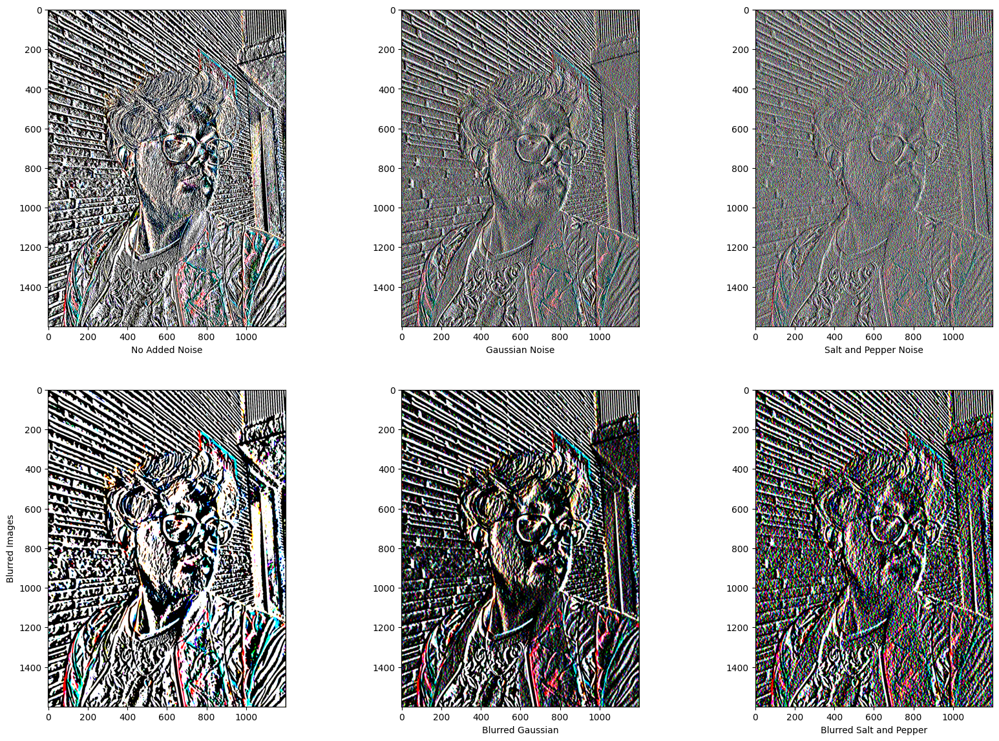

In [13]:
sobelXk = cv.Sobel(src=karan, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)
sobelXgk = cv.Sobel(src=gaussKaran, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)
sobelXspk = cv.Sobel(src=saltPepKaran, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)
blurredsobelXk = cv.Sobel(src=karanBlurred, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)
blurredsobelXgk = cv.Sobel(src=gaussKaranBlurred, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)
blurredsobelXspk = cv.Sobel(src=saltPepKaranBlurred, ddepth=cv.CV_64F, dx=1, dy=0, ksize=5)

fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(sobelXk)
ax[0][0].set_xlabel("No Added Noise")

ax[0][1].imshow(sobelXgk)
ax[0][1].set_xlabel("Gaussian Noise")

ax[0][2].imshow(sobelXspk)
ax[0][2].set_xlabel("Salt and Pepper Noise")

ax[1][0].imshow(blurredsobelXk)
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(blurredsobelXgk)
ax[1][1].set_xlabel("Blurred Gaussian")

ax[1][2].imshow(blurredsobelXspk)
ax[1][2].set_xlabel("Blurred Salt and Pepper")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 0, 'Blurred Salt and Pepper')

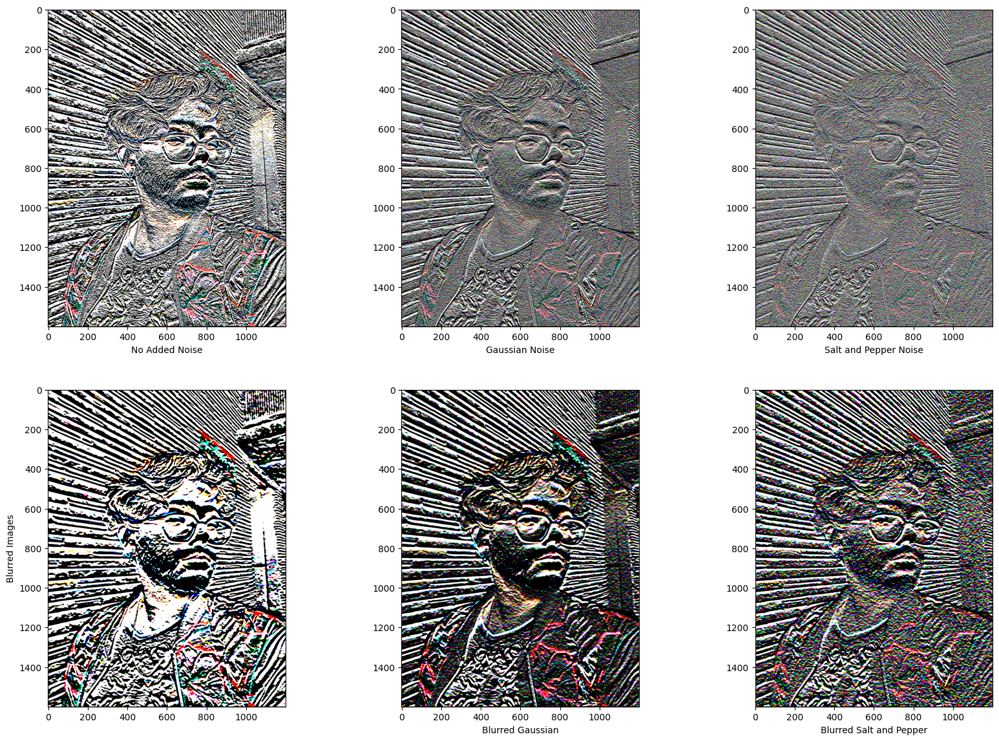

In [14]:
sobelYk = cv.Sobel(src=karan, ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)
sobelYgk = cv.Sobel(src=gaussKaran, ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)
sobelYspk = cv.Sobel(src=saltPepKaran, ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)
blurredsobelYk = cv.Sobel(
    src=karanBlurred, ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)
blurredsobelYgk = cv.Sobel(src=gaussKaranBlurred,
                           ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)
blurredsobelYspk = cv.Sobel(src=saltPepKaranBlurred,
                            ddepth=cv.CV_64F, dx=0, dy=1, ksize=5)

fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(sobelYk)
ax[0][0].set_xlabel("No Added Noise")

ax[0][1].imshow(sobelYgk)
ax[0][1].set_xlabel("Gaussian Noise")

ax[0][2].imshow(sobelYspk)
ax[0][2].set_xlabel("Salt and Pepper Noise")

ax[1][0].imshow(blurredsobelYk)
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(blurredsobelYgk)
ax[1][1].set_xlabel("Blurred Gaussian")

ax[1][2].imshow(blurredsobelYspk)
ax[1][2].set_xlabel("Blurred Salt and Pepper")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 0, 'Blurred Salt and Pepper')

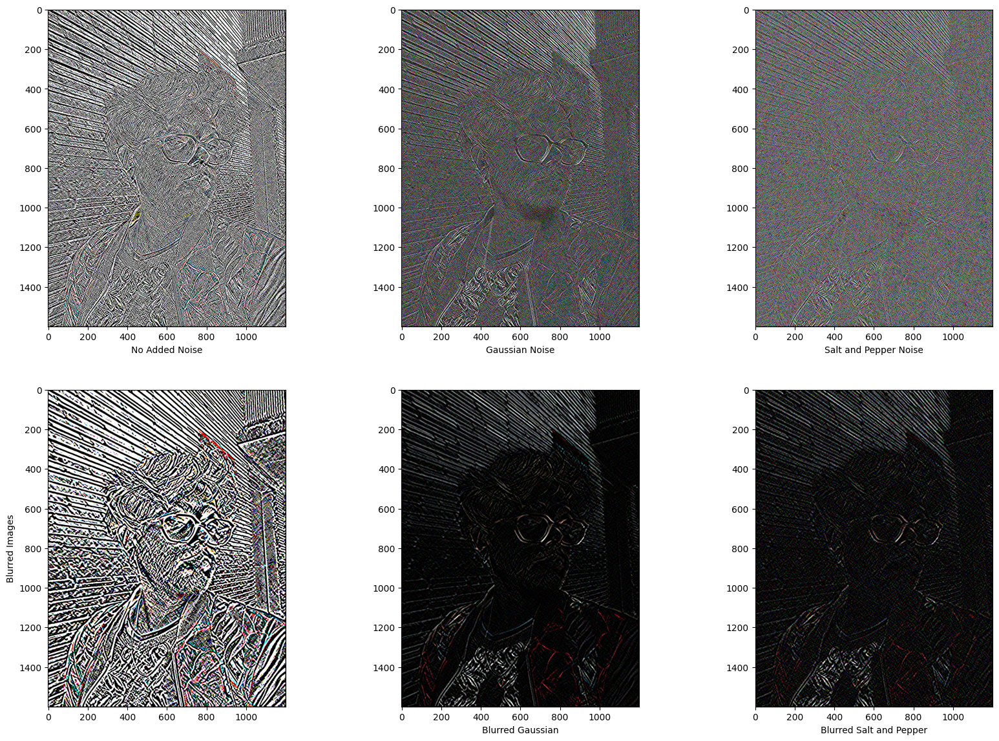

In [22]:
sobelXYk = cv.Sobel(src=karan, ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)
sobelXYgk = cv.Sobel(src=gaussKaran, ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)
sobelXYspk = cv.Sobel(src=saltPepKaran, ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)
blurredsobelXYk = cv.Sobel(
    src=karanBlurred, ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)
blurredsobelXYgk = cv.Sobel(src=gaussKaranBlurred,
                           ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)
blurredsobelXYspk = cv.Sobel(src=saltPepKaranBlurred,
                            ddepth=cv.CV_64F, dx=1, dy=1, ksize=5)

fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(sobelXYk)
ax[0][0].set_xlabel("No Added Noise")

ax[0][1].imshow(sobelXYgk)
ax[0][1].set_xlabel("Gaussian Noise")

ax[0][2].imshow(sobelXYspk)
ax[0][2].set_xlabel("Salt and Pepper Noise")

ax[1][0].imshow(blurredsobelXYk)
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(blurredsobelXYgk)
ax[1][1].set_xlabel("Blurred Gaussian")

ax[1][2].imshow(blurredsobelXYspk)
ax[1][2].set_xlabel("Blurred Salt and Pepper")


### Laplacian Edge Detection

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 0, 'Blurred Salt and Pepper')

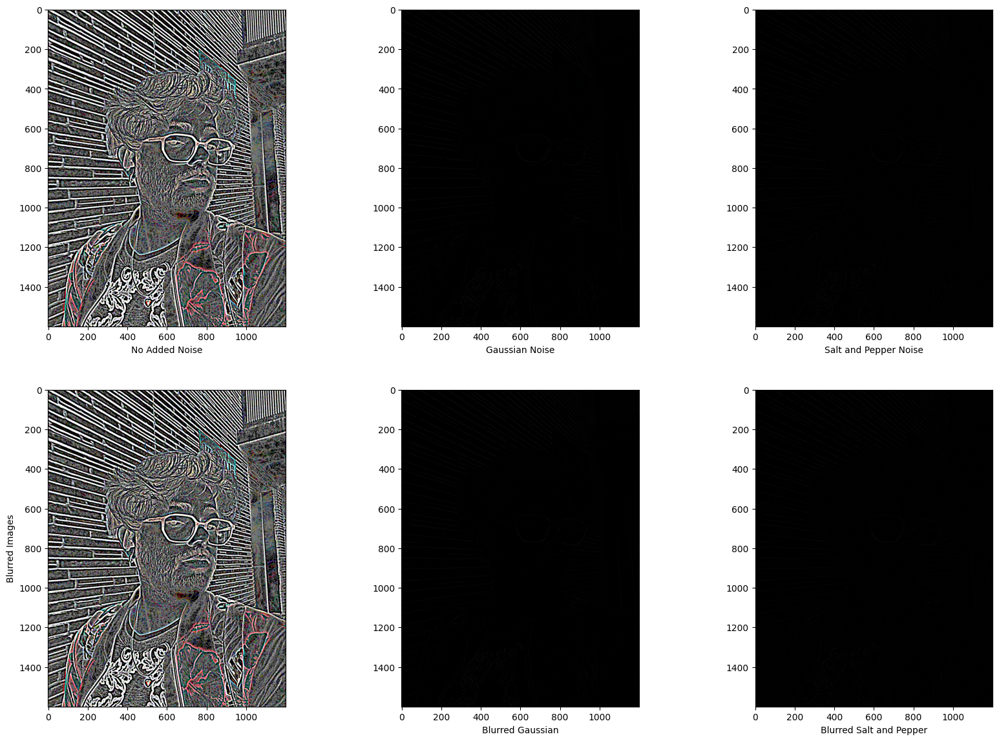

In [15]:
Laplaciank = cv.Laplacian(src=karan, ddepth=cv.CV_64F)
Laplaciangk = cv.Laplacian(src=gaussKaran, ddepth=cv.CV_64F)
Laplacianspk = cv.Laplacian(src=saltPepKaran, ddepth=cv.CV_64F)
Laplaciank = cv.Laplacian(
    src=karanBlurred, ddepth=cv.CV_64F)
Laplaciangk = cv.Laplacian(src=gaussKaranBlurred,
                           ddepth=cv.CV_64F)
Laplacianspk = cv.Laplacian(src=saltPepKaranBlurred,
                            ddepth=cv.CV_64F)

fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(Laplaciank)
ax[0][0].set_xlabel("No Added Noise")

ax[0][1].imshow(Laplaciangk)
ax[0][1].set_xlabel("Gaussian Noise")

ax[0][2].imshow(Laplacianspk)
ax[0][2].set_xlabel("Salt and Pepper Noise")

ax[1][0].imshow(Laplaciank)
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(Laplaciangk)
ax[1][1].set_xlabel("Blurred Gaussian")

ax[1][2].imshow(Laplacianspk)
ax[1][2].set_xlabel("Blurred Salt and Pepper")


### Canny Edge Detection

The Canny edge detector is an edge detection operator that uses a multi-stage algorithm to detect a wide range of edges in images.

+ There are 5 steps in the edge detection algorithm:
    1. Noise reduction
    2. Gradient calculation
    3. Non-maximum suppression
    4. Double threshold
    5. Edge Tracking by Hysteresis

In [54]:
grayKaran = rgb2gray(karan)
grayGaussKaran = rgb2gray(gaussKaran)
graySaltPepKaran = rgb2gray(saltPepKaran)
grayKaranBlurred = rgb2gray(karanBlurred)
grayGaussKaranBlurred = rgb2gray(gaussKaranBlurred)
graySaltPepKaranBlurred = rgb2gray(saltPepKaranBlurred)

In [56]:
Cannyk = cv.Canny(grayKaran, 50, 150)
Cannygk = cv.Canny(grayGaussKaran, 50, 150)
Cannyspk = cv.Canny(graySaltPepKaran, 50, 150)
blurredCannyk = cv.Canny(grayKaranBlurred, 50, 150)
blurredCannygk = cv.Canny(grayGaussKaranBlurred, 50, 150)
blurredCannyspk = cv.Canny(graySaltPepKaranBlurred, 50, 150)

fig, ax = plt.subplots(2, 3, figsize=(20, 14))

ax[0][0].imshow(Cannyk, cmap ='gray')
ax[0][0].set_xlabel("No Added Noise")

ax[0][1].imshow(Cannygk, cmap ='gray')
ax[0][1].set_xlabel("Gaussian Noise")

ax[0][2].imshow(Cannyspk, cmap ='gray')
ax[0][2].set_xlabel("Salt and Pepper Noise")

ax[1][0].imshow(blurredCannyk, cmap ='gray')
ax[1][0].set_ylabel("Blurred Images")

ax[1][1].imshow(blurredCannygk, cmap ='gray')
ax[1][1].set_xlabel("Blurred Gaussian")

ax[1][2].imshow(blurredCannyspk, cmap ='gray')
ax[1][2].set_xlabel("Blurred Salt and Pepper")


error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\canny.cpp:829: error: (-215:Assertion failed) _src.depth() == CV_8U in function 'cv::Canny'


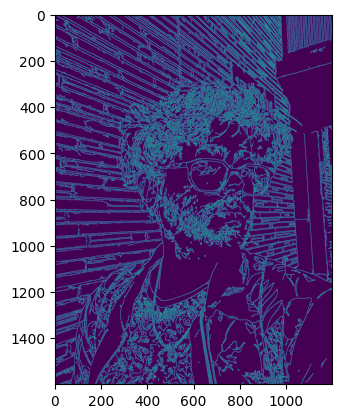

In [41]:

Cannyk = cv.Canny(rgb2gray(karan) , 50, 150)
Cannygk = cv.Canny(rgb2gray(gaussKaran) , 50, 150)
Cannyspk = cv.Canny(rgb2gray(saltPepKaran) , 50, 150)
blurredCannyk = cv.Canny(rgb2gray(karanBlurred) , 50, 150)
blurredCannygk = cv.Canny(rgb2gray(gaussKaranBlurred) , 50, 150)
blurredCannyspk = cv.Canny(rgb2gray(saltPepKaranBlurred) , 50, 150)

plt.imshow(Cannyk)

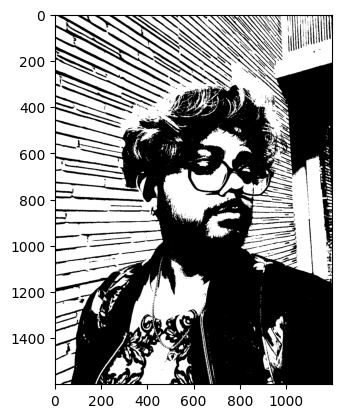

In [51]:
grayKaran = rgb2gray(karan)
grayR = grayKaran
mean = grayR.mean()

for i in range(grayR.shape[0]):
    for j in range(grayR.shape[1]):
        if grayR[i][j] > mean:
            grayR[i][j] = 1
        else:
            grayR[i][j] = 0
            
grayKaran = grayR
plt.imshow(grayKaran, cmap='gray')


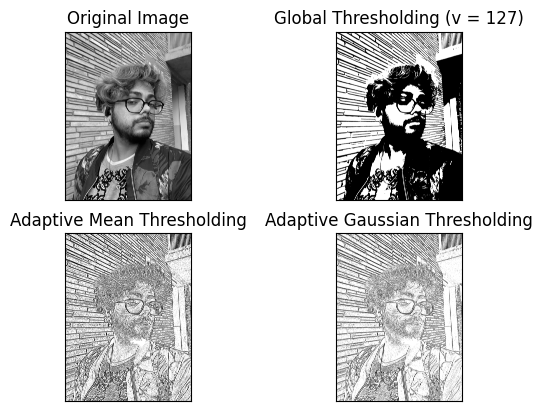

In [58]:
karanCV = cv.imread('karanCV.jpg', 0)
karanCV = cv.medianBlur(karanCV, 5)

ret, th1 = cv.threshold(karanCV, 127, 255, cv.THRESH_BINARY)
th2 = cv.adaptiveThreshold(karanCV, 255, cv.ADAPTIVE_THRESH_MEAN_C,
                            cv.THRESH_BINARY, 11, 2)
th3 = cv.adaptiveThreshold(karanCV, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C,
                            cv.THRESH_BINARY, 11, 2)

titles = ['Original Image', 'Global Thresholding (v = 127)',
          'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [karanCV, th1, th2, th3]

for i in range(4):
    plt.subplot(2, 2, i+1), plt.imshow(images[i], 'gray')
    plt.title(titles[i])
    plt.xticks([]), plt.yticks([])
plt.show()


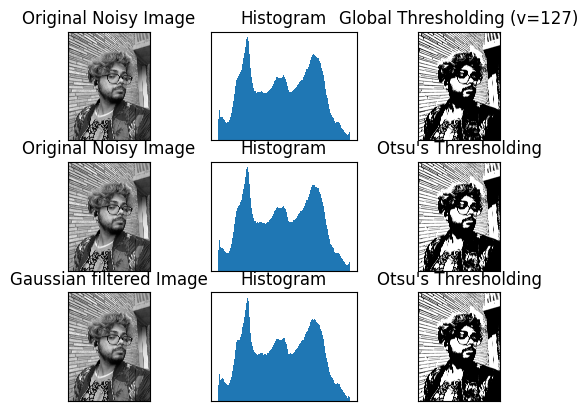

In [60]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

img = cv.imread('karan.jpg', 0)

# global thresholding
ret1, th1 = cv.threshold(img, 127, 255, cv.THRESH_BINARY)

# Otsu's thresholding
ret2, th2 = cv.threshold(img, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)

# Otsu's thresholding after Gaussian filtering
blur = cv.GaussianBlur(img, (5, 5), 0)
ret3, th3 = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)

# plot all the images and their histograms
images = [img, 0, th1,
          img, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image', 'Histogram', 'Global Thresholding (v=127)',
          'Original Noisy Image', 'Histogram', "Otsu's Thresholding",
          'Gaussian filtered Image', 'Histogram', "Otsu's Thresholding"]

for i in range(3):
    plt.subplot(3, 3, i*3+1), plt.imshow(images[i*3], 'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3, 3, i*3+2), plt.hist(images[i*3].ravel(), 256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3, 3, i*3+3), plt.imshow(images[i*3+2], 'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()
